In [0]:
from pyspark.sql import SparkSession
spark = SparkSession.builder.appName("IPL-Session").getOrCreate()

from pyspark.sql.types import *
from pyspark.sql.functions import *
from pyspark.sql.window import Window
import matplotlib.pyplot as plt
import seaborn as sns

In [0]:
ball_by_ball_schema = StructType([
    StructField("match_id", IntegerType(), True),
    StructField("over_id", IntegerType(), True),
    StructField("ball_id", IntegerType(), True),
    StructField("innings_no", IntegerType(), True),
    StructField("team_batting", StringType(), True),
    StructField("team_bowling", StringType(), True),
    StructField("striker_batting_position", IntegerType(), True),
    StructField("extra_type", StringType(), True),
    StructField("runs_scored", IntegerType(), True),
    StructField("extra_runs", IntegerType(), True),
    StructField("wides", IntegerType(), True),
    StructField("legbyes", IntegerType(), True),
    StructField("byes", IntegerType(), True),
    StructField("noballs", IntegerType(), True),
    StructField("penalty", IntegerType(), True),
    StructField("bowler_extras", IntegerType(), True),
    StructField("out_type", StringType(), True),
    StructField("caught", BooleanType(), True),
    StructField("bowled", BooleanType(), True),
    StructField("run_out", BooleanType(), True),
    StructField("lbw", BooleanType(), True),
    StructField("retired_hurt", BooleanType(), True),
    StructField("stumped", BooleanType(), True),
    StructField("caught_and_bowled", BooleanType(), True),
    StructField("hit_wicket", BooleanType(), True),
    StructField("obstructingfeild", BooleanType(), True),
    StructField("bowler_wicket", BooleanType(), True),
    StructField("match_date", DateType(), True),
    StructField("season", IntegerType(), True),
    StructField("striker", IntegerType(), True),
    StructField("non_striker", IntegerType(), True),
    StructField("bowler", IntegerType(), True),
    StructField("player_out", IntegerType(), True),
    StructField("fielders", IntegerType(), True),
    StructField("striker_match_sk", IntegerType(), True),
    StructField("strikersk", IntegerType(), True),
    StructField("nonstriker_match_sk", IntegerType(), True),
    StructField("nonstriker_sk", IntegerType(), True),
    StructField("fielder_match_sk", IntegerType(), True),
    StructField("fielder_sk", IntegerType(), True),
    StructField("bowler_match_sk", IntegerType(), True),
    StructField("bowler_sk", IntegerType(), True),
    StructField("playerout_match_sk", IntegerType(), True),
    StructField("battingteam_sk", IntegerType(), True),
    StructField("bowlingteam_sk", IntegerType(), True),
    StructField("keeper_catch", BooleanType(), True),
    StructField("player_out_sk", IntegerType(), True),
    StructField("matchdatesk", DateType(), True)
])


In [0]:
ball_by_ball_df = spark.read.csv("/Volumes/workspace/ipl-dataset/ipl-volume/Ball_By_Ball.csv", header=True, schema=ball_by_ball_schema)

In [0]:
match_schema = StructType([
    StructField("match_sk", IntegerType(), True),
    StructField("match_id", IntegerType(), True),
    StructField("team1", StringType(), True),
    StructField("team2", StringType(), True),
    StructField("match_date", DateType(), True),
    StructField("season_year", IntegerType(), True),  # Use IntegerType instead of YearType (not available)
    StructField("venue_name", StringType(), True),
    StructField("city_name", StringType(), True),
    StructField("country_name", StringType(), True),
    StructField("toss_winner", StringType(), True),
    StructField("match_winner", StringType(), True),
    StructField("toss_name", StringType(), True),
    StructField("win_type", StringType(), True),
    StructField("outcome_type", StringType(), True),
    StructField("manofmach", StringType(), True),
    StructField("win_margin", IntegerType(), True),
    StructField("country_id", IntegerType(), True)
])


In [0]:
match_df = spark.read.csv("/Volumes/workspace/ipl-dataset/ipl-volume/Match.csv", header=True, schema=match_schema)

In [0]:
player_schema = StructType([
    StructField("player_sk", IntegerType(), True),
    StructField("player_id", IntegerType(), True),
    StructField("player_name", StringType(), True),
    StructField("dob", DateType(), True),
    StructField("batting_hand", StringType(), True),
    StructField("bowling_skill", StringType(), True),
    StructField("country_name", StringType(), True)
])


In [0]:
player_df = spark.read.csv("/Volumes/workspace/ipl-dataset/ipl-volume/Player.csv", header=True , schema= player_schema)

In [0]:

player_match_schema = StructType([
    StructField("player_match_sk", IntegerType(), True),
    StructField("playermatch_key", DecimalType(20, 5), True),  # Adjust precision/scale if needed
    StructField("match_id", IntegerType(), True),
    StructField("player_id", IntegerType(), True),
    StructField("player_name", StringType(), True),
    StructField("dob", DateType(), True),
    StructField("batting_hand", StringType(), True),
    StructField("bowling_skill", StringType(), True),
    StructField("country_name", StringType(), True),
    StructField("role_desc", StringType(), True),
    StructField("player_team", StringType(), True),
    StructField("opposit_team", StringType(), True),
    StructField("season_year", IntegerType(), True),  # No YearType in Spark
    StructField("is_manofthematch", BooleanType(), True),
    StructField("age_as_on_match", IntegerType(), True),
    StructField("isplayers_team_won", BooleanType(), True),
    StructField("batting_status", StringType(), True),
    StructField("bowling_status", StringType(), True),
    StructField("player_captain", StringType(), True),
    StructField("opposit_captain", StringType(), True),
    StructField("player_keeper", StringType(), True),
    StructField("opposit_keeper", StringType(), True)
])


In [0]:
player_match_df = spark.read.csv("/Volumes/workspace/ipl-dataset/ipl-volume/Player_match.csv", header=True,schema=player_match_schema)

In [0]:
team_schema = StructType([
    StructField("team_sk", IntegerType(), True),
    StructField("team_id", IntegerType(), True),
    StructField("team_name", StringType(), True)
])


In [0]:
team_df = spark.read.csv("/Volumes/workspace/ipl-dataset/ipl-volume/Team.csv", header=True, schema=team_schema)

In [0]:
#Filter to include only valid deliveries (excluding extras like wides and no balls for specific analyses)
ball_by_ball_df = ball_by_ball_df.filter((col("wides") == 0) & (col("noballs")==0))
display(ball_by_ball_df)


match_id,over_id,ball_id,innings_no,team_batting,team_bowling,striker_batting_position,extra_type,runs_scored,extra_runs,wides,legbyes,byes,noballs,penalty,bowler_extras,out_type,caught,bowled,run_out,lbw,retired_hurt,stumped,caught_and_bowled,hit_wicket,obstructingfeild,bowler_wicket,match_date,season,striker,non_striker,bowler,player_out,fielders,striker_match_sk,strikersk,nonstriker_match_sk,nonstriker_sk,fielder_match_sk,fielder_sk,bowler_match_sk,bowler_sk,playerout_match_sk,battingteam_sk,bowlingteam_sk,keeper_catch,player_out_sk,matchdatesk
598028,15,6,1,5,2,6,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2013,277,104,83,null,null,20336,276,20333,103,-1,-1,20343,82,-1,4,1,false,0,null
598028,14,1,1,5,2,5,No Extras,1,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2013,104,6,346,null,null,20333,103,20328,5,-1,-1,20348,345,-1,4,1,false,0,null
598028,14,2,1,5,2,3,No Extras,1,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,false,0,null
598028,14,3,1,5,2,5,No Extras,1,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2013,104,6,346,null,null,20333,103,20328,5,-1,-1,20348,345,-1,4,1,false,0,null
598028,14,4,1,5,2,3,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,false,0,null
598028,14,5,1,5,2,3,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,false,0,null
598028,14,6,1,5,2,3,No Extras,2,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,false,0,null
598028,13,1,1,5,2,5,No Extras,1,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2013,104,6,83,null,null,20333,103,20328,5,-1,-1,20343,82,-1,4,1,false,0,null
598028,13,2,1,5,2,3,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2013,6,104,83,null,null,20328,5,20333,103,-1,-1,20343,82,-1,4,1,false,0,null
598028,13,3,1,5,2,3,No Extras,1,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2013,6,104,83,null,null,20328,5,20333,103,-1,-1,20343,82,-1,4,1,false,0,null


In [0]:
#Aggregation: Calculate the total and average runs scored in each match and inning
total_and_avg_runs = ball_by_ball_df.groupBy("match_id", "innings_no").agg(
    sum("runs_scored").alias("total_runs"),
    avg("runs_scored").alias("average_runs")
)

display(total_and_avg_runs)

match_id,innings_no,total_runs,average_runs
548339,1,156,1.3109243697478992
548330,1,83,0.7155172413793104
548351,2,91,0.8348623853211009
980942,2,163,1.393162393162393
548328,2,123,1.025
734018,2,129,1.084033613445378
548344,2,161,1.3529411764705883
548316,2,115,1.116504854368932
729316,1,129,1.075
980966,1,143,1.1916666666666667


In [0]:
# Window Function: Calculate running total of runs in each match for each over
windowSpec = Window.partitionBy("match_id","innings_no").orderBy("over_id")

ball_by_ball_df = ball_by_ball_df.withColumn(
    "running_total_runs",
    sum("runs_scored").over(windowSpec)
)

display(ball_by_ball_df)

match_id,over_id,ball_id,innings_no,team_batting,team_bowling,striker_batting_position,extra_type,runs_scored,extra_runs,wides,legbyes,byes,noballs,penalty,bowler_extras,out_type,caught,bowled,run_out,lbw,retired_hurt,stumped,caught_and_bowled,hit_wicket,obstructingfeild,bowler_wicket,match_date,season,striker,non_striker,bowler,player_out,fielders,striker_match_sk,strikersk,nonstriker_match_sk,nonstriker_sk,fielder_match_sk,fielder_sk,bowler_match_sk,bowler_sk,playerout_match_sk,battingteam_sk,bowlingteam_sk,keeper_catch,player_out_sk,matchdatesk,running_total_runs
335987,1,1,1,1,2,1,legbyes,0,1,0,1,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,1,2,14,null,null,12705,0,12706,1,-1,-1,12702,13,-1,0,1,false,0,null,0
335987,1,2,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,null,0
335987,1,4,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,null,0
335987,1,5,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,null,0
335987,1,6,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,null,0
335987,1,7,1,1,2,2,legbyes,0,1,0,1,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,null,0
335987,2,1,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,null,18
335987,2,2,1,1,2,2,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,null,18
335987,2,3,1,1,2,2,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,null,18
335987,2,4,1,1,2,2,No Extras,6,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,null,18


In [0]:
# Conditional Column: Flag for high impact balls (either a wicket or more than 6 runs including extras)
ball_by_ball_df = ball_by_ball_df.withColumn(
    "high_impact",
    when((col("runs_scored") + col("extra_runs") > 6) | (col("bowler_wicket") == True), True).otherwise(False)
)
display(ball_by_ball_df)

match_id,over_id,ball_id,innings_no,team_batting,team_bowling,striker_batting_position,extra_type,runs_scored,extra_runs,wides,legbyes,byes,noballs,penalty,bowler_extras,out_type,caught,bowled,run_out,lbw,retired_hurt,stumped,caught_and_bowled,hit_wicket,obstructingfeild,bowler_wicket,match_date,season,striker,non_striker,bowler,player_out,fielders,striker_match_sk,strikersk,nonstriker_match_sk,nonstriker_sk,fielder_match_sk,fielder_sk,bowler_match_sk,bowler_sk,playerout_match_sk,battingteam_sk,bowlingteam_sk,keeper_catch,player_out_sk,matchdatesk,running_total_runs,high_impact
335987,1,1,1,1,2,1,legbyes,0,1,0,1,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,1,2,14,null,null,12705,0,12706,1,-1,-1,12702,13,-1,0,1,false,0,null,0,false
335987,1,2,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,null,0,false
335987,1,4,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,null,0,false
335987,1,5,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,null,0,false
335987,1,6,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,null,0,false
335987,1,7,1,1,2,2,legbyes,0,1,0,1,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,14,null,null,12706,1,12705,0,-1,-1,12702,13,-1,0,1,false,0,null,0,false
335987,2,1,1,1,2,2,No Extras,0,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,null,18,false
335987,2,2,1,1,2,2,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,null,18,false
335987,2,3,1,1,2,2,No Extras,4,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,null,18,false
335987,2,4,1,1,2,2,No Extras,6,0,0,0,0,0,0,0,Not Applicable,false,false,false,false,false,false,false,false,false,false,null,2008,2,1,15,null,null,12706,1,12705,0,-1,-1,12703,14,-1,0,1,false,0,null,18,false


In [0]:
from pyspark.sql.functions import year, month, dayofmonth, when

# Extracting year, month, and day from the match date for more detailed time-based analysis
match_df = match_df.withColumn("year", year("match_date"))
match_df = match_df.withColumn("month", month("match_date"))
match_df = match_df.withColumn("day", dayofmonth("match_date"))

# High margin win: categorizing win margins into 'high', 'medium', and 'low'
match_df = match_df.withColumn(
    "win_margin_category",
    when(col("win_margin") >= 100, "High")
    .when((col("win_margin") >= 50) & (col("win_margin") < 100), "Medium")
    .otherwise("Low")
)

# Analyze the impact of the toss: who wins the toss and the match
match_df = match_df.withColumn(
    "toss_match_winner",
    when(col("toss_winner") == col("match_winner"), "Yes").otherwise("No")
)

# Show the enhanced match DataFrame
display(match_df)

match_sk,match_id,team1,team2,match_date,season_year,venue_name,city_name,country_name,toss_winner,match_winner,toss_name,win_type,outcome_type,manofmach,win_margin,country_id,year,month,day,win_margin_category,toss_match_winner
0,335987,Royal Challengers Bangalore,Kolkata Knight Riders,null,2008,M Chinnaswamy Stadium,Bangalore,India,Royal Challengers Bangalore,Kolkata Knight Riders,field,runs,Result,BB McCullum,140,1,null,null,null,High,No
1,335988,Kings XI Punjab,Chennai Super Kings,null,2008,"Punjab Cricket Association Stadium, Mohali",Chandigarh,India,Chennai Super Kings,Chennai Super Kings,bat,runs,Result,MEK Hussey,33,1,null,null,null,Low,Yes
2,335989,Delhi Daredevils,Rajasthan Royals,null,2008,Feroz Shah Kotla,Delhi,India,Rajasthan Royals,Delhi Daredevils,bat,wickets,Result,MF Maharoof,9,1,null,null,null,Low,No
3,335990,Mumbai Indians,Royal Challengers Bangalore,null,2008,Wankhede Stadium,Mumbai,India,Mumbai Indians,Royal Challengers Bangalore,bat,wickets,Result,MV Boucher,5,1,null,null,null,Low,No
4,335991,Kolkata Knight Riders,Deccan Chargers,null,2008,Eden Gardens,Kolkata,India,Deccan Chargers,Kolkata Knight Riders,bat,wickets,Result,DJ Hussey,5,1,null,null,null,Low,No
5,335992,Rajasthan Royals,Kings XI Punjab,null,2008,Sawai Mansingh Stadium,Jaipur,India,Kings XI Punjab,Rajasthan Royals,bat,wickets,Result,SR Watson,6,1,null,null,null,Low,No
6,335993,Deccan Chargers,Delhi Daredevils,null,2008,"Rajiv Gandhi International Stadium, Uppal",Hyderabad,India,Deccan Chargers,Delhi Daredevils,bat,wickets,Result,V Sehwag,9,1,null,null,null,Low,No
7,335994,Chennai Super Kings,Mumbai Indians,null,2008,"MA Chidambaram Stadium, Chepauk",Chennai,India,Mumbai Indians,Chennai Super Kings,field,runs,Result,ML Hayden,6,1,null,null,null,Low,No
8,335995,Deccan Chargers,Rajasthan Royals,null,2008,"Rajiv Gandhi International Stadium, Uppal",Hyderabad,India,Rajasthan Royals,Rajasthan Royals,field,wickets,Result,YK Pathan,3,1,null,null,null,Low,Yes
9,335996,Kings XI Punjab,Mumbai Indians,null,2008,"Punjab Cricket Association Stadium, Mohali",Chandigarh,India,Mumbai Indians,Kings XI Punjab,field,runs,Result,KC Sangakkara,66,1,null,null,null,Medium,No


In [0]:
from pyspark.sql.functions import lower, regexp_replace

# Normalize and clean player names
player_df = player_df.withColumn("player_name", lower(regexp_replace("player_name", "[^a-zA-Z0-9 ]", "")))

# Handle missing values in 'batting_hand' and 'bowling_skill' with a default 'unknown'
player_df = player_df.na.fill({"batting_hand": "unknown", "bowling_skill": "unknown"})

# Categorizing players based on batting hand
player_df = player_df.withColumn(
    "batting_style",
    when(col("batting_hand").contains("Left"), "Left-Handed").otherwise("Right-Handed")
)

# Show the enhanced player DataFrame
display(player_df)

player_sk,player_id,player_name,dob,batting_hand,bowling_skill,country_name,batting_style
0,1,sc ganguly,null,Left-hand bat,Right-arm medium,India,Left-Handed
1,2,bb mccullum,null,Right-hand bat,Right-arm medium,New Zealand,Right-Handed
2,3,rt ponting,null,Right-hand bat,Right-arm medium,Australia,Right-Handed
3,4,dj hussey,null,Right-hand bat,Right-arm offbreak,Australia,Right-Handed
4,5,mohammad hafeez,null,Right-hand bat,Right-arm offbreak,Pakistan,Right-Handed
5,6,r dravid,null,Right-hand bat,Right-arm offbreak,India,Right-Handed
6,7,w jaffer,null,Right-hand bat,Right-arm offbreak,India,Right-Handed
7,8,v kohli,null,Right-hand bat,Right-arm medium,India,Right-Handed
8,9,jh kallis,null,Right-hand bat,Right-arm fast-medium,South Africa,Right-Handed
9,10,cl white,null,Right-hand bat,Legbreak googly,Australia,Right-Handed


In [0]:
from pyspark.sql.functions import col, when, current_date, expr

# Add a 'veteran_status' column based on player age
player_match_df = player_match_df.withColumn(
    "veteran_status",
    when(col("age_as_on_match") >= 35, "Veteran").otherwise("Non-Veteran")
)

# Dynamic column to calculate years since debut
player_match_df = player_match_df.withColumn(
    "years_since_debut",
    (year(current_date()) - col("season_year"))
)

In [0]:
ball_by_ball_df.createOrReplaceTempView("ball_by_ball")
match_df.createOrReplaceTempView("match")
player_df.createOrReplaceTempView("player")
player_match_df.createOrReplaceTempView("player_match")
team_df.createOrReplaceTempView("team")

In [0]:
top_scoring_batsmen_per_season = spark.sql("""
SELECT 
p.player_name,
m.season_year,
SUM(b.runs_scored) AS total_runs 
FROM ball_by_ball b
JOIN match m ON b.match_id = m.match_id   
JOIN player_match pm ON m.match_id = pm.match_id AND b.striker = pm.player_id     
JOIN player p ON p.player_id = pm.player_id
GROUP BY p.player_name, m.season_year
ORDER BY m.season_year, total_runs DESC
""")

In [0]:
economical_bowlers_powerplay = spark.sql("""
SELECT 
p.player_name, 
AVG(b.runs_scored) AS avg_runs_per_ball, 
COUNT(b.bowler_wicket) AS total_wickets
FROM ball_by_ball b
JOIN player_match pm ON b.match_id = pm.match_id AND b.bowler = pm.player_id
JOIN player p ON pm.player_id = p.player_id
WHERE b.over_id <= 6
GROUP BY p.player_name
HAVING COUNT(*) >= 1
ORDER BY avg_runs_per_ball, total_wickets DESC
""")

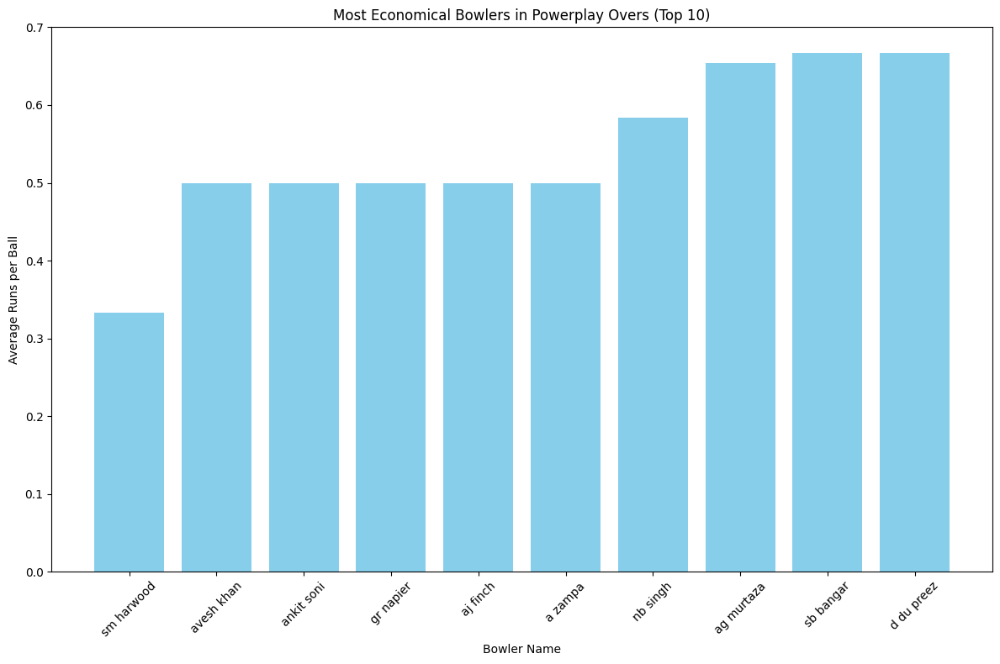

In [0]:
# Assuming 'economical_bowlers_powerplay' is already executed and available as a Spark DataFrame
economical_bowlers_pd = economical_bowlers_powerplay.toPandas()

# Visualizing using Matplotlib
plt.figure(figsize=(12, 8))
# Limiting to top 10 for clarity in the plot
top_economical_bowlers = economical_bowlers_pd.nsmallest(10, 'avg_runs_per_ball')
plt.bar(top_economical_bowlers['player_name'], top_economical_bowlers['avg_runs_per_ball'], color='skyblue')
plt.xlabel('Bowler Name')
plt.ylabel('Average Runs per Ball')
plt.title('Most Economical Bowlers in Powerplay Overs (Top 10)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [0]:
toss_impact_individual_matches = spark.sql("""
SELECT m.match_id, m.toss_winner, m.toss_name, m.match_winner,
       CASE WHEN m.toss_winner = m.match_winner THEN 'Won' ELSE 'Lost' END AS match_outcome
FROM match m
WHERE m.toss_name IS NOT NULL
ORDER BY m.match_id
""")

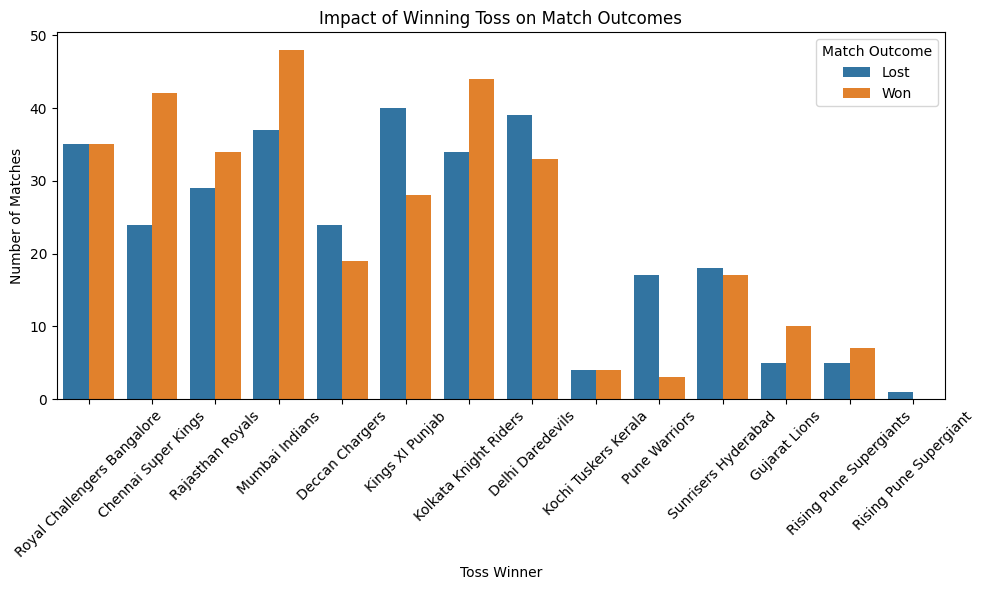

In [0]:
toss_impact_pd = toss_impact_individual_matches.toPandas()

# Creating a countplot to show win/loss after winning toss
plt.figure(figsize=(10, 6))
sns.countplot(x='toss_winner', hue='match_outcome', data=toss_impact_pd)
plt.title('Impact of Winning Toss on Match Outcomes')
plt.xlabel('Toss Winner')
plt.ylabel('Number of Matches')
plt.legend(title='Match Outcome')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [0]:
average_runs_in_wins = spark.sql("""
SELECT p.player_name, AVG(b.runs_scored) AS avg_runs_in_wins, COUNT(*) AS innings_played
FROM ball_by_ball b
JOIN player_match pm ON b.match_id = pm.match_id AND b.striker = pm.player_id
JOIN player p ON pm.player_id = p.player_id
JOIN match m ON pm.match_id = m.match_id
WHERE m.match_winner = pm.player_team
GROUP BY p.player_name
ORDER BY avg_runs_in_wins ASC
""")

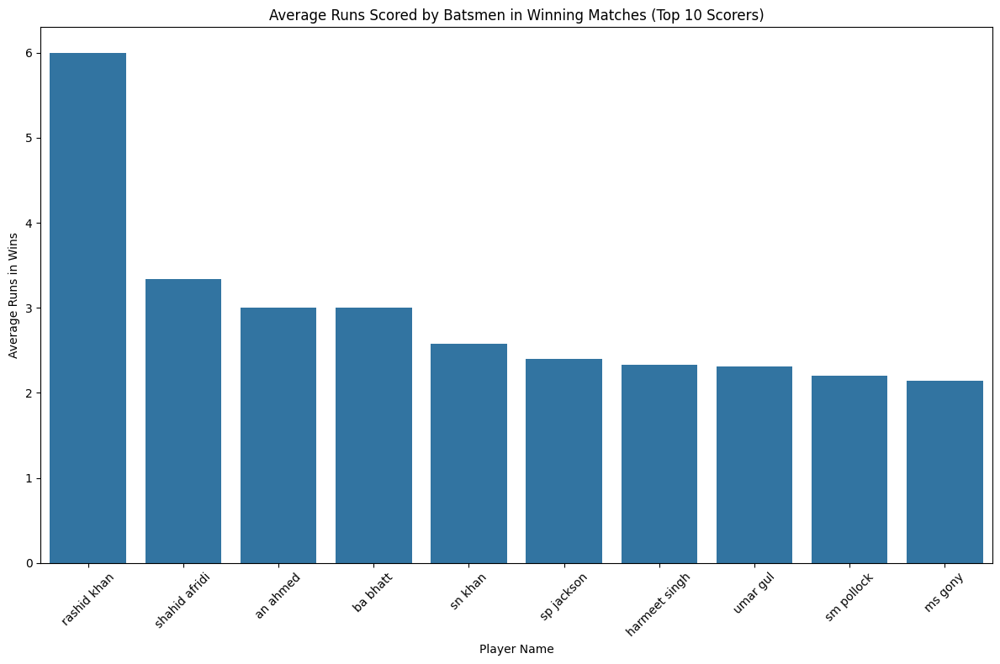

In [0]:
average_runs_pd = average_runs_in_wins.toPandas()

# Using seaborn to plot average runs in winning matches
plt.figure(figsize=(12, 8))
top_scorers = average_runs_pd.nlargest(10, 'avg_runs_in_wins')
sns.barplot(x='player_name', y='avg_runs_in_wins', data=top_scorers)
plt.title('Average Runs Scored by Batsmen in Winning Matches (Top 10 Scorers)')
plt.xlabel('Player Name')
plt.ylabel('Average Runs in Wins')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [0]:
# Execute SQL Query
scores_by_venue = spark.sql("""
SELECT venue_name, AVG(total_runs) AS average_score, MAX(total_runs) AS highest_score
FROM (
    SELECT ball_by_ball.match_id, match.venue_name, SUM(runs_scored) AS total_runs
    FROM ball_by_ball
    JOIN match ON ball_by_ball.match_id = match.match_id
    GROUP BY ball_by_ball.match_id, match.venue_name
)
GROUP BY venue_name
ORDER BY average_score DESC
""")


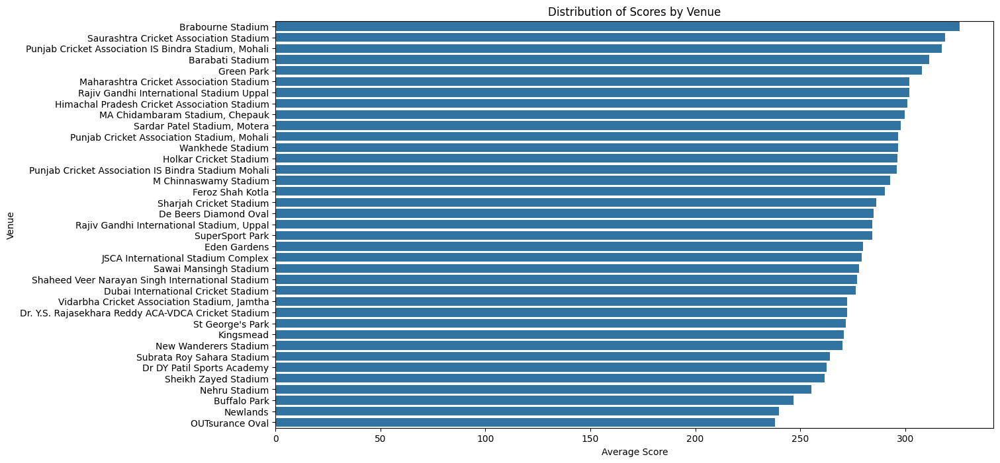

In [0]:
# Convert to Pandas DataFrame
scores_by_venue_pd = scores_by_venue.toPandas()

# Plot
plt.figure(figsize=(14, 8))
sns.barplot(x='average_score', y='venue_name', data=scores_by_venue_pd)
plt.title('Distribution of Scores by Venue')
plt.xlabel('Average Score')
plt.ylabel('Venue')
plt.show()

In [0]:
# Execute SQL Query
dismissal_types = spark.sql("""
SELECT out_type, COUNT(*) AS frequency
FROM ball_by_ball
WHERE out_type IS NOT NULL
GROUP BY out_type
ORDER BY frequency DESC
""")

/home/spark-6eb8bcf0-275b-44f4-a067-90/.ipykernel/2436/command-5874600878081116-169784400:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='frequency', y='out_type', data=dismissal_types_pd, palette='pastel')


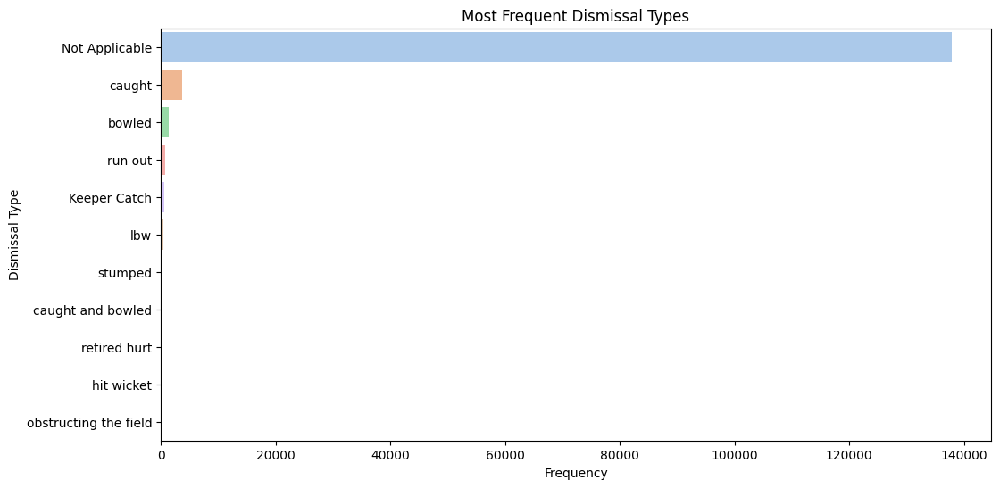

In [0]:
# Convert to Pandas DataFrame
dismissal_types_pd = dismissal_types.toPandas()

# Plot
plt.figure(figsize=(12, 6))
sns.barplot(x='frequency', y='out_type', data=dismissal_types_pd, palette='pastel')
plt.title('Most Frequent Dismissal Types')
plt.xlabel('Frequency')
plt.ylabel('Dismissal Type')
plt.show()

In [0]:
# Execute SQL Query
team_toss_win_performance = spark.sql("""
SELECT team1, COUNT(*) AS matches_played, SUM(CASE WHEN toss_winner = match_winner THEN 1 ELSE 0 END) AS wins_after_toss
FROM match
WHERE toss_winner = team1
GROUP BY team1
ORDER BY wins_after_toss DESC
""")


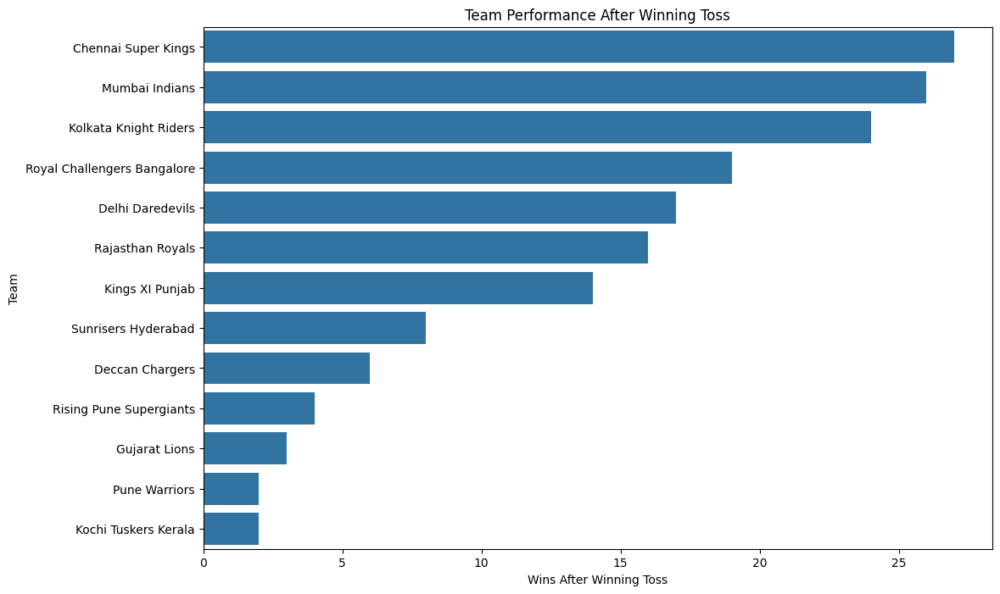

In [0]:
# Convert to Pandas DataFrame
team_toss_win_pd = team_toss_win_performance.toPandas()

# Plot
plt.figure(figsize=(12, 8))
sns.barplot(x='wins_after_toss', y='team1', data=team_toss_win_pd)
plt.title('Team Performance After Winning Toss')
plt.xlabel('Wins After Winning Toss')
plt.ylabel('Team')
plt.show()
